# **Download Yolov5 From Github**

In [11]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

#''' do this one time '''

c:\Users\gozoh\Downloads\AI_FP\yolov5
Cloning into 'yolov5'...
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [3]:
# install dependencies as necessary
!pip install -qr requirements.txt

#''' I comment some pytorch stuffs in the txt 
#    to download GPU version regarding to pytorch website '''

c:\Users\gozoh\Downloads\AI_FP\yolov5


In [2]:
%cd yolov5

#''' run this when reopening this notebook '''

c:\Users\gozoh\Downloads\AI_FP\yolov5


In [2]:

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

#''' python 3.7.10 BTW '''

Setup complete. Using torch 1.9.0 _CudaDeviceProperties(name='NVIDIA GeForce RTX 3080', major=8, minor=6, total_memory=10240MB, multi_processor_count=68)


In [ ]:
# **Connect With Google Drive**

In [ ]:
'''from google.colab import drive
drive.mount('/content/gdrive')'''

Mounted at /content/gdrive


# **Download Image From RoboFlow**

In [10]:
# Export code snippet and paste here

# Rotate+Brightness+Flip+Blur+Crop--636--1600 https://app.roboflow.com/ds/mERovx1GmA?key=CfPvOEm9V3 x
# Rotate+Brightness+Flip+Blur+Gray--636--1600 https://app.roboflow.com/ds/zpnImlwCmW?key=reUChdZmtm x
# Rotate+Brightness+Flip+Crop+Shear+Gray--636--1600
# Rotate+Brightness+Flip+Crop+Shear--636--1600
# Rotate+Brightness+Flip+Crop--636--1600 https://app.roboflow.com/ds/NhWxQHDwba?key=rJYqtSzJha 
# Rotate+Brightness+Flip+Gray--636--1600 https://app.roboflow.com/ds/NjHT1NaUBj?key=TUK86RDa3H v
# Rotate+Brightness+Flip--636--1600 https://app.roboflow.com/ds/kp9LcYLLPr?key=5Er4MRVC7H v
# Rotate+Brightness+Blur--636--1600 https://app.roboflow.com/ds/kpMoXRPWEw?key=pocQXmrxBn v
# Rotate+Brightness+Flip--636--1600 https://app.roboflow.com/ds/nOx1yXalf7?key=prHS29Bmgk v
# Rotate+Brightness--636--1600 https://app.roboflow.com/ds/EwPN28c5Wj?key=SfIgF5Sly6 v
# Rotate--636--1300 https://app.roboflow.com/ds/jcIe9MDISG?key=IHyh9dFu85 v
# Brightness--636-1600 https://app.roboflow.com/ds/V53TuCcgte?key=JIwulxBl3j v
# Rotate+Brightness--683--1700 https://app.roboflow.com/ds/nZq1hImwaZ?key=dPDqiQPGdR v
# Rotate+Brightness+Flip--683--1700 https://app.roboflow.com/ds/6Tq4fVAjwa?key=EVVsbhbyQC v
# Rotate+Brightness+Flip+Gray--683--1700 https://app.roboflow.com/ds/2nCYygNeab?key=qMFkktWLa1 v

# Rotate+Brightness+Flip+Blur(best) https://app.roboflow.com/ds/Rdi1KVWh0a?key=dGmKWzKHhU
!curl -L "https://app.roboflow.com/ds/Rdi1KVWh0a?key=dGmKWzKHhU" > roboflow.zip
import zipfile
with zipfile.ZipFile('roboflow.zip', 'r') as zip_ref:
    zip_ref.extractall()

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed

  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100   896  100   896    0     0    896      0  0:00:01 --:--:--  0:00:01  1145

  0 31.6M    0   215    0     0    215      0 42:50:34  0:00:01 42:50:33   215
  9 31.6M    9 3038k    0     0  1519k      0  0:00:21  0:00:02  0:00:19  9.9M
 41 31.6M   41 13.1M    0     0  4485k      0  0:00:07  0:00:03  0:00:04 10.1M
 75 31.6M   75 24.0M    0     0  6152k      0  0:00:05  0:00:04  0:00:01 10.4M
100 31.6M  100 31.6M    0     0  8095k      0  0:00:04  0:00:04 --:--:-- 10.5M


**Output Class Name**

In [11]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
#%cat data.yaml
with open('data.yaml', 'r') as f:
    print(f.read())

#''' windows version of cat '''

train: ../train/images
val: ../valid/images

nc: 4
names: ['1', '10', '5', '50']


# **Define Model Configuration and Architecture**

In [12]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

#''' run all these cells once and you are goos '''

In [13]:
#this is the model configuration we will use for our tutorial 
#%cat /content/yolov5/models/yolov5s.yaml
with open('models/yolov5s.yaml', 'r') as f:
    print(f.read())

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [14]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [15]:
%%writetemplate models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# **Train Custom YOLOv5 Detector**

In [89]:
%%time

# default, with pretrain-weight(yolov5s.pt)
#!python train.py --img 416 --batch 16 --epochs 300 --data ../data.yaml --cfg ./models/custom_yolov5s.yaml --weights ../yolov5s.pt --name yolov5s_results  --cache
# training something base on best weight
#!python train.py --img 416 --batch 16 --epochs 200 --data ../data_sup.yaml --cfg ./models/custom_yolov5s.yaml --weights ./runs/train/yolov5s_results26/weights/best.pt --name yolov5s_results  --cache
# ~ 2000 imgs training
!python train.py --img 416 --batch 16 --epochs 1000 --data ../all/data.yaml --cfg ./models/custom_yolov5s.yaml --weights ../yolov5s.pt --name yolov5s_results  --cache

#''' train & valid imgs' path is in data.yaml '''
#''' EDIT yourself: --data, --weights '''

github:  WARNING: code is out of date by 292 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
Wall time: 2h 35s
From https://github.com/ultralytics/yolov5
   9fceabc..ec999c6  fix/images_to_labels -> origin/fix/images_to_labels
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0 CUDA:0 (NVIDIA GeForce RTX 3080, 10240.0MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='../all/data.yaml', device='', entity=None, epochs=1000, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], linear_lr=False, local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs\\train\\yolov5s_results', single_cls=False, sync_bn=False, total_batch_size=16, weights='../yolov5s.pt', workers=2, wo

# **Evaluate Custom YOLOv5 Detector Performance**

In [82]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 32596), started 0:00:19 ago. (Use '!kill 32596' to kill it.)

In [3]:
cd yolov5

c:\Users\gozoh\Downloads\AI_FP\yolov5


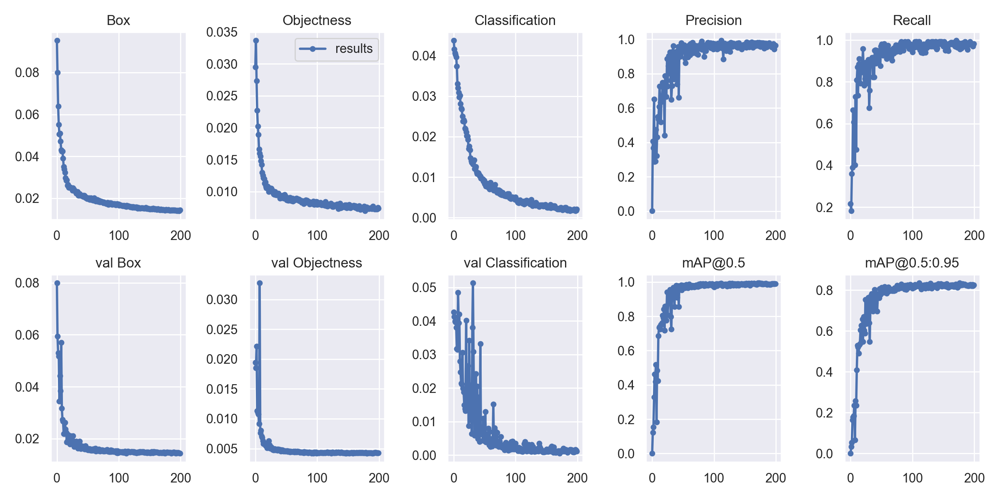

In [85]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results
from IPython.display import Image

Image(filename='runs/train/yolov5s_results30/results.png', width=1000)

#''' EDIT yourself: runs/train/yolov5s_results_ '''

**Visualize Our Training Data**

GROUND TRUTH TRAINING DATA:


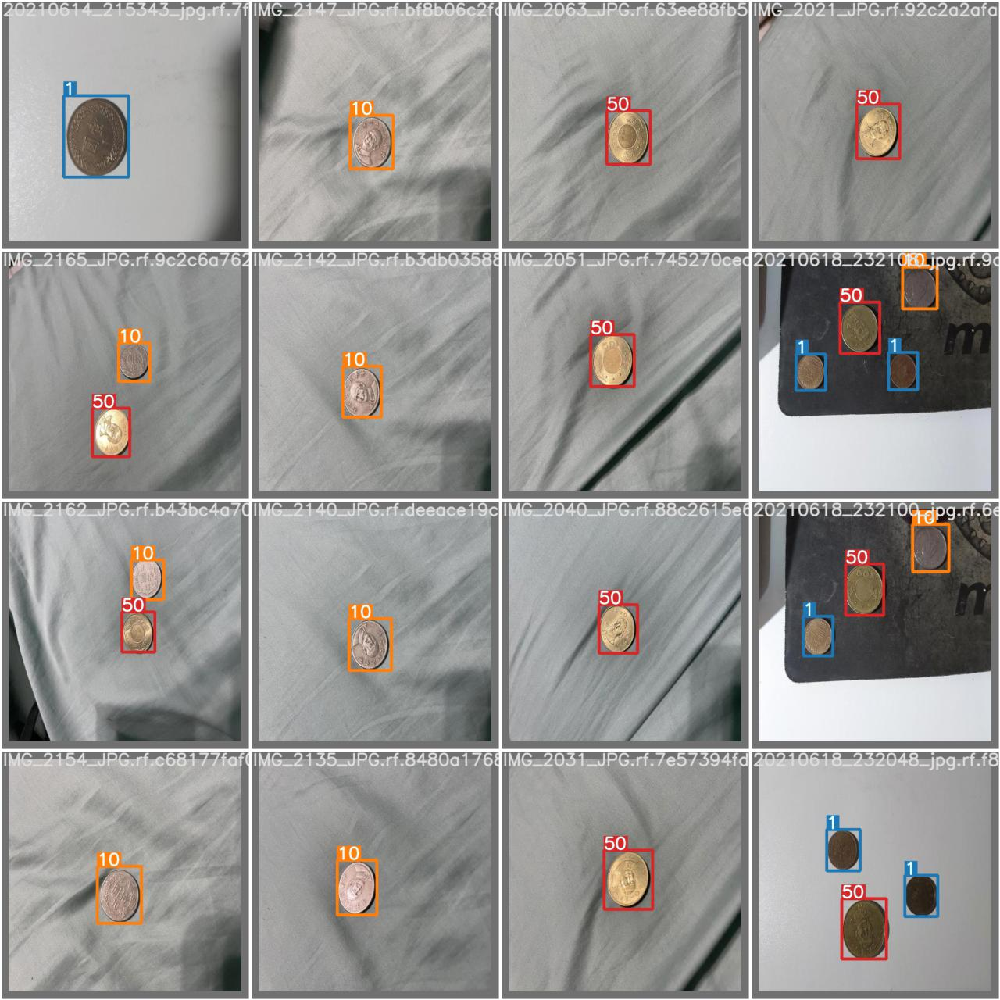

In [7]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='runs/train/yolov5s_results23/test_batch0_labels.jpg', width=900)

#''' EDIT yourself: runs/train/yolov5s_results_ '''


# **Testing Time**

In [2]:
cd yolov5

c:\Users\gozoh\Downloads\AI_FP\yolov5


In [91]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!

#result26 -> best(mAP=~84%)
# test data (106 imgs)
#!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 720 --conf 0.5 --save-txt --save-conf --source "C:/Users/gozoh/Downloads/drive-download-20210620T072339Z-001/images" --agnostic
# detect a video
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 720 --conf 0.5 --save-txt --save-conf --source "C:/Users/gozoh/Downloads/f.MOV" --agnostic
# real time, --source 0
#!python detect.py --weights runs/train/yolov5s_results26/weights/best.pt --img-size 720 --conf 0.5 --save-txt --save-conf --source 0 --agnostic

#''' enable --agnostic so a object has only 1 class --- '''
#''' EDIT yourself: --weights, source'''

Namespace(agnostic_nms=True, augment=False, classes=None, conf_thres=0.5, device='', exist_ok=False, img_size=720, iou_thres=0.45, name='exp', project='runs/detect', save_conf=True, save_txt=True, source='C:/Users/gozoh/Downloads/drive-download-20210620T072339Z-001/images', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
Fusing layers... 
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0 CUDA:0 (NVIDIA GeForce RTX 3080, 10240.0MB)

D:\Users\gozoh\anaconda3\envs\yolo\lib\site-packages\torch\nn\functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ..\c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Model Summary: 232 layers, 7254609 parameters, 0 gradients, 16.8 GFLOPS
image 1/106 C:\Users\gozoh\Downloads\drive-download-202

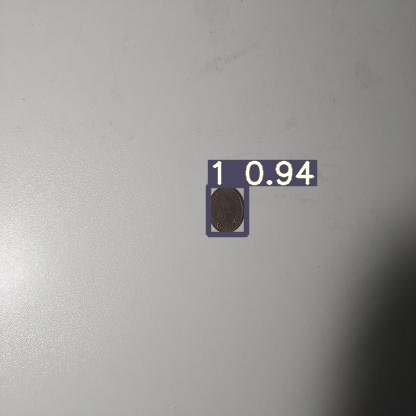

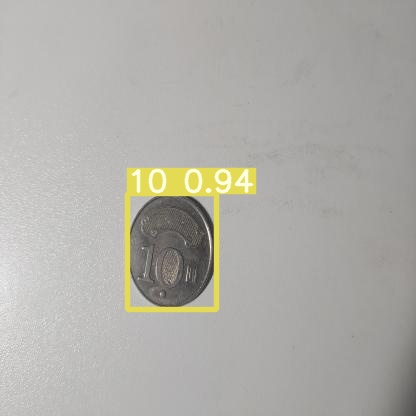

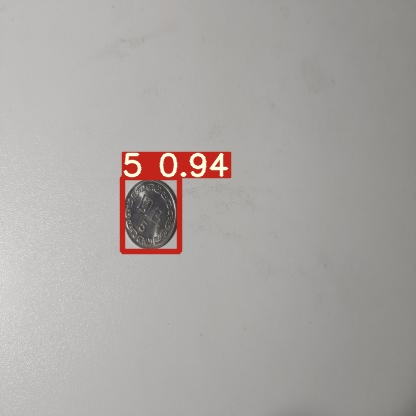

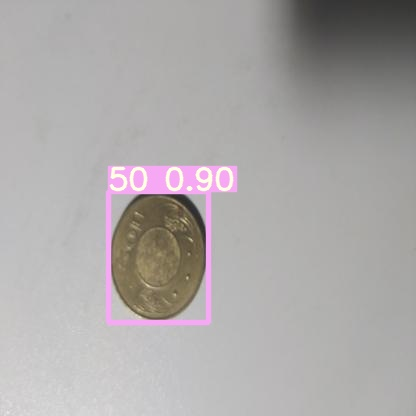

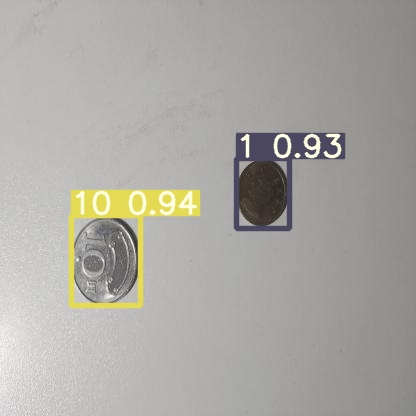

...

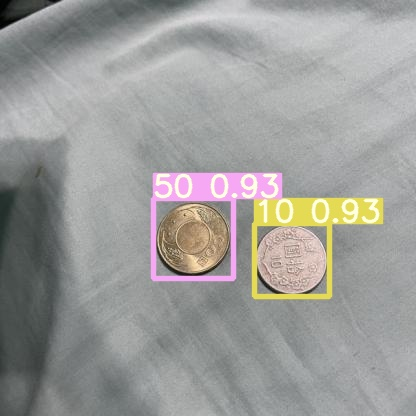

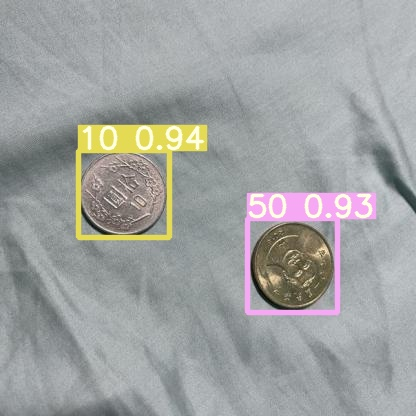

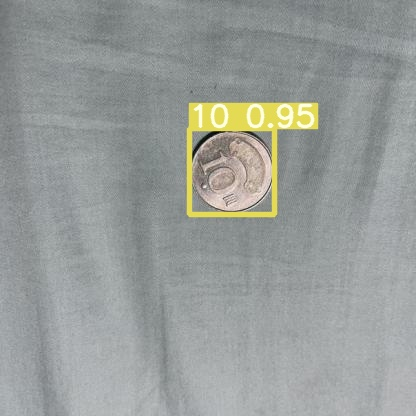

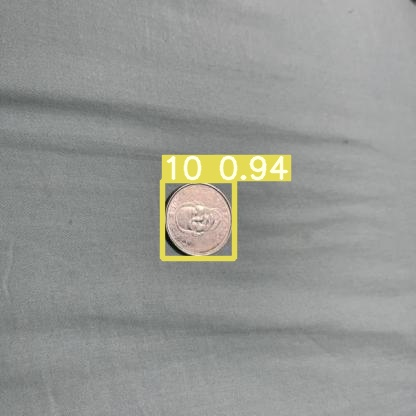

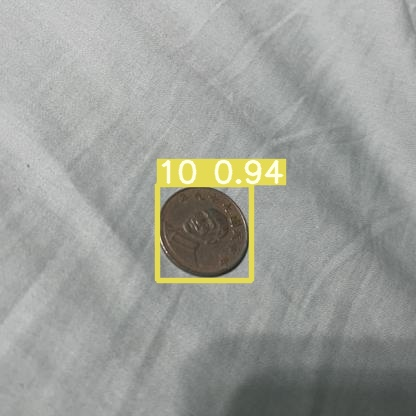

In [11]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/detect/exp60/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

#''' EDIT yourself: runs/detect/exp_ '''

**Calculate the Money and Trouble Shooting**

In [7]:
import glob
import cv2 as cv
from IPython.display import Image, display

def indexToClass(classIndex):
  if(classIndex == str(0)): return int(1)
  elif(classIndex == str(1)): return int(10)
  elif(classIndex == str(2)): return int(5)
  elif(classIndex == str(3)): return int(50)
  elif(classIndex == str(4)): return int(0)

def calculation(imagePath):
  for num in range(len(imagePath)):
    resultPath = imagePath[num].replace("exp/", "exp/labels/")
    currentResultPath = resultPath[0:-3]+"txt"
    f = open(currentResultPath, 'r') # open single file
    print("Image %s" %(imagePath[num]))

    classIndex, boundingBox = [], []
    for line in f.readlines():
      index = line.find(" ")
      classIndex.append(line[0:index])
      boundingBox.append(line[index+1:-1].split()) # split class and bounding box location

    difference = []
    for i in range(len(boundingBox)):     # detecting overlapping bounding boxes
      difference.append([1] * (len(boundingBox)))
      for j in range(len(boundingBox)):
        if(abs(float(boundingBox[i][0])-float(boundingBox[j][0]))>0.05 or abs(float(boundingBox[i][1])-float(boundingBox[j][1]))>0.05): difference[i][j] = 1
        else: difference[i][j] = 0

    for i in range(len(boundingBox)):
      for j in range(len(boundingBox)): 
        if(i!=j and not difference[i][j]): # compare with the confidence
          if(boundingBox[i][4]>boundingBox[j][4] and (classIndex[i]!="4" and classIndex[j]!="4")):
            print("\tOverlap Detected: Select Class %d with Confidence %s Discard Class %d with Confidence %s" %(indexToClass(classIndex[i]), boundingBox[i][4], indexToClass(classIndex[j]), boundingBox[j][4]))
            classIndex[j] = str(4)
          elif(boundingBox[i][4]<=boundingBox[j][4] and (classIndex[i]!="4" and classIndex[j]!="4")): 
            print("\tOverlap Detected: Select Class %d with Confidence %s Discard Class %d with Confidence %s" %(indexToClass(classIndex[j]), boundingBox[j][4], indexToClass(classIndex[i]), boundingBox[i][4]))
            classIndex[i] = str(4) 

    totalDollar = 0 # counting total dollars
    for coin in classIndex:
      totalDollar += indexToClass(coin)
    
    img = cv.imread(imagePath[num])
    height, width = img.shape[:2]
    ratio = width/height
    resizeImg = cv.resize(img, (int(728*ratio), 728), interpolation=cv.INTER_AREA)
    newHeight, newWidth = resizeImg.shape[:2]
    font, bottomLeftCornerOfText, fontScale, fontColor, lineScale= cv.FONT_HERSHEY_DUPLEX, (10,int(newHeight*0.98)), 1, (0,255,255), 2
    cv.putText(resizeImg, "Total Dollar: "+str(totalDollar), bottomLeftCornerOfText, font, fontScale, fontColor, lineScale)
    cv.imwrite('output.jpg', resizeImg) 
    
    display(Image(filename='output.jpg'))
    print("Total Dollar: %d\n" %(totalDollar))

    #''' its broken somehow '''

Image: runs/detect/exp5/labels\IMG_3053.jpg	Total: 141 NTD
Image: runs/detect/exp5/labels\IMG_3054.jpg	Total: 101 NTD
Image: runs/detect/exp5/labels\IMG_3055.jpg	Total: 111 NTD
Image: runs/detect/exp5/labels\IMG_3057.jpg	Total: 151 NTD
Image: runs/detect/exp5/labels\IMG_3058.jpg	Total: 151 NTD
Image: runs/detect/exp5/labels\IMG_3059.jpg	Total: 172 NTD
Image: runs/detect/exp5/labels\IMG_3060.jpg	Total: 132 NTD
Image: runs/detect/exp5/labels\IMG_3061.jpg	Total: 81 NTD
Image: runs/detect/exp5/labels\IMG_3062.jpg	Total: 81 NTD
Overlap Detected: Confindence Comparison 0.620605 vs 0.633789
Overlap Detected: Confindence Comparison 0.633789 vs 0.620605
Image: runs/detect/exp5/labels\IMG_3063.jpg	Total: 101 NTD
Image: runs/detect/exp5/labels\IMG_3065.jpg	Total: 60 NTD
Image: runs/detect/exp5/labels\IMG_3066.jpg	Total: 32 NTD
Image: runs/detect/exp5/labels\IMG_3067.jpg	Total: 132 NTD
Image: runs/detect/exp5/labels\IMG_3068.jpg	Total: 82 NTD
Image: runs/detect/exp5/labels\IMG_3069.jpg	Total: 142 

In [92]:
import os, shutil
def copytree(src, dst, symlinks=False, ignore=None):
    for item in os.listdir(src):
        s = os.path.join(src, item)
        d = os.path.join(dst, item)
        if os.path.isdir(s):
            shutil.copytree(s, d, symlinks, ignore)
        else:
            shutil.copy2(s, d)
%cd C:/Users/gozoh/Downloads/AI_FP/yolov5
copytree("runs/detect/exp87/labels", "../mAP/tmp")
%cd ../mAP/tmp
!python Format.py
%cd ../

copytree('tmp', "input/detection-results")
os.remove("input/detection-results/Format.py")
!python main.py
%cd ../yolov5

#''' to calculate mAP, move result txt to mAP repo's input dir
#    swap difficulty from last col to second col by running Format.py
#    run main.py to get mAP in /mAP '''
#''' EDIT yourself: runs/detect/exp_ '''


C:\Users\gozoh\Downloads\AI_FP\yolov5
C:\Users\gozoh\Downloads\AI_FP\mAP\tmp
C:\Users\gozoh\Downloads\AI_FP\mAP
92.20% = 0 AP 
93.57% = 1 AP 
51.18% = 2 AP 
96.47% = 3 AP 
mAP = 83.35%
Figure(640x480)
C:\Users\gozoh\Downloads\AI_FP\yolov5
main.py:704: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title('AP ' + class_name)
main.py:298: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title(window_title)


In [ ]:
# **Export Trained Weights**
#''' muda after this cell '''

In [ ]:
%cp runs/train/yolov5s_results23/weights/best.pt /content/gdrive/My\ Drive

**Download txt files**

In [ ]:
!zip -r /content/test/labels.zip /content/test/labels
!zip -r /content/yolov5/runs/detect/exp/labels.zip /content/yolov5/runs/detect/exp/labels
from google.colab import files
files.download("/content/test/labels.zip")
files.download("/content/yolov5/runs/detect/exp/labels.zip")

  adding: content/test/labels/ (stored 0%)
  adding: content/test/labels/20210615_012211821_iOS_jpg.rf.3e7ced08d3d644861386bb40e77b248a.txt (deflated 34%)
  adding: content/test/labels/IMG_E2026_JPG.rf.d3d8cbddb77b172c24cee2294ecdc042.txt (deflated 38%)
  adding: content/test/labels/20210614_215733_jpg.rf.d5c01f88fbacae84278c38e8df996883.txt (deflated 68%)
  adding: content/test/labels/20210615_011605655_iOS_jpg.rf.2bf9b8b35459eab893bbba9d1193360d.txt (deflated 36%)
  adding: content/test/labels/20210615_012504113_iOS_jpg.rf.cc7b8426d9ad5f31ff36743e6fc3fbc9.txt (deflated 31%)
  adding: content/test/labels/IMG_E2080_JPG.rf.0a11530ba0b7fdff329877fd1cd588a6.txt (deflated 35%)
  adding: content/test/labels/20210615_012240501_iOS_jpg.rf.72b2140fda649722dfb251a9ed2a226c.txt (deflated 38%)
  adding: content/test/labels/20210615_011711418_iOS_jpg.rf.2dbd74d2b6d6ffae6eefee7fc55b6cba.txt (deflated 34%)
  adding: content/test/labels/IMG_2052_JPG.rf.1bea6ba30ba6876a3987e5582ec27c4d.txt (deflated 3

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>